In [1]:
# Import required libraries

# pandas - For data manipulation and analysis of tabular data (landmarks and protocol files)
import pandas as pd

# numpy - For numerical operations and array manipulation of pupil measurements
import numpy as np

# matplotlib - For creating static visualizations of pupil response data
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.colors import to_rgba

# pathlib - For cross-platform file path handling
from pathlib import Path

# logging - For tracking program execution and debugging information
import logging

# scipy.signal - For signal processing operations like Savitzky-Golay filtering
from scipy import signal

# seaborn - For enhanced statistical data visualization built on matplotlib
import seaborn as sns

# shapely.geometry - For polygon area calculation
from shapely.geometry import Polygon
from scipy.interpolate import CubicSpline # Add this import

# Configure logging
logging.basicConfig(
    level=logging.INFO,
    format='%(asctime)s - %(levelname)s - %(message)s'
)
logger = logging.getLogger(__name__)

In [2]:
def load_validate_file(file_path):
    """
    Load and validate landmarks data file
    
    Args:
        file_path (str): Path to landmarks CSV file
        
    Returns:
        pd.DataFrame: Processed landmarks data
    """
    try:
        df = pd.read_csv(file_path)
        
        # Required columns for timestamp and status
        base_columns = ['timestamp', 'id', 'retcode']
        
        # Generate expected landmark column names for both eyes
        landmark_columns = []
        for eye in ['left', 'right']:
            for i in range(1, 28):  # 27 landmarks per eye
                landmark_columns.extend([
                    f'{eye}_lm_{i}_x',
                    f'{eye}_lm_{i}_y'
                ])
        
        required_columns = base_columns + landmark_columns
        
        # Verify all required columns exist
        missing_columns = [col for col in required_columns if col not in df.columns]
        if missing_columns:
            raise ValueError(f"Missing required columns: {', '.join(missing_columns)}")
            
        logger.info(f"Successfully validated landmarks file {file_path.name} with {len(df)} rows")
        return df
    except Exception as e:
        logger.error(f"Error loading landmarks file: {e}")
        raise

data_path = Path().cwd().parent / "data"
# for subfolder in data_path.iterdir():
#     if subfolder.is_dir():
#         # landmarks_file = subfolder / f'{subfolder.name}_plr_landmarks.csv'
#         # protocol_file = subfolder / f'{subfolder.name}_plr_protocol.csv'
        
#         # Load landmarks and protocol files
#         landmarks_df = load_validate_file(landmarks_file)
#         # protocol_df = load_protocol_file(protocol_file)

# Find the landmarks.csv file
landmarks_file = list(data_path.glob('**/*landmarks.csv'))

first_plr_file = landmarks_file[1]

# Load landmarks data into DataFrame
landmarks_df = pd.read_csv(first_plr_file)

# Display first few rows
landmarks_df.head()  # Added .head() to display first few rows

,Unnamed: 0,timestamp,id,retcode,left_lm_1_x,left_lm_1_y,left_lm_2_x,left_lm_2_y,left_lm_3_x,left_lm_3_y,...,right_lm_23_x,right_lm_23_y,right_lm_24_x,right_lm_24_y,right_lm_25_x,right_lm_25_y,right_lm_26_x,right_lm_26_y,right_lm_27_x,right_lm_27_y
0,0,2024-08-08 03:36:14.477,1650,OK,178.0,507.5,234.0,465.2,272.0,458.8,...,792.0,461.8,756.5,461.8,757.0,481.2,844.5,458.2,886.5,487.8
1,1,2024-08-08 03:36:14.514,1651,OK,182.2,508.2,236.8,466.0,275.5,459.5,...,792.0,464.5,762.0,464.8,762.0,481.2,847.8,461.5,887.0,490.8
2,2,2024-08-08 03:36:14.548,1652,OK,175.8,509.8,231.5,468.0,271.2,461.2,...,788.0,468.5,757.8,468.8,757.8,485.2,846.2,461.8,885.0,491.8
3,3,2024-08-08 03:36:14.580,1653,OK,173.5,510.0,229.2,467.5,268.2,461.0,...,781.2,469.8,757.8,469.8,757.8,482.5,843.0,463.5,880.8,491.0
4,4,2024-08-08 03:36:14.609,1654,OK,171.5,511.0,226.8,469.5,265.8,463.8,...,779.2,472.2,756.0,472.5,756.0,486.2,838.5,463.2,874.8,490.2


In [3]:
def filter_ok_landmarks_data(df):
    """
    Clean landmarks data by removing invalid frames
    
    Args:
        df (pd.DataFrame): Raw landmarks data
        
    Returns:
        pd.DataFrame: Cleaned landmarks data
    """
    # Remove frames with invalid retCode
    cleaned_df = df[df['retcode'] == 'OK'].copy()
    
    # Reset index after filtering
    cleaned_df.reset_index(drop=True, inplace=True)
    
    logger.info(f"Removed {len(df) - len(cleaned_df)} frames with invalid retCode")
    return cleaned_df

landmarks_df_cleaned = filter_ok_landmarks_data(landmarks_df)

2025-04-16 01:56:16,199 - INFO - Removed 1 frames with invalid retCode


In [4]:
numerical_cols = landmarks_df_cleaned.select_dtypes(include=['float64', 'int64']).columns.tolist()
exclude_cols = ['Unnamed: 0', 'id']
landmark_cols = [col for col in numerical_cols if col not in exclude_cols]
landmark_cols[:5]

['left_lm_1_x', 'left_lm_1_y', 'left_lm_2_x', 'left_lm_2_y', 'left_lm_3_x']

In [5]:
# Drop rows with index 30 to 42
landmarks_df_cleaned.drop(landmarks_df_cleaned.index[30:43], inplace=True)

# Reset index after dropping rows
landmarks_df_cleaned.reset_index(drop=True, inplace=True)

# Display the shape of the dataframe after dropping rows
print(f"Shape after dropping rows 30-42: {landmarks_df_cleaned.shape}")

Shape after dropping rows 30-42: (223, 112)


# Pupil Size Extraction

In [6]:
def get_pupil_boundary_points(frame, eye):
    """Extract pupil boundary points for a specific eye and frame"""
    boundary_points = []
    for lm in [7, 25, 9, 22, 10, 23, 24]:  # Pupil landmarks (not closing the loop with 7 again)
        x = frame[f'{eye}_lm_{lm}_x'].iloc[0]
        y = frame[f'{eye}_lm_{lm}_y'].iloc[0]
        boundary_points.append((x, y))
    return boundary_points

def get_pupil_center(frame, eye):
    """Get the center point (landmark 8) of the pupil"""
    center_x = frame[f'{eye}_lm_8_x'].iloc[0]
    center_y = frame[f'{eye}_lm_8_y'].iloc[0]
    return center_x, center_y

def cartesian_to_polar(center, boundary_points):
    """Convert Cartesian boundary points to polar coordinates relative to the center."""
    points_polar = []
    for p in boundary_points:
        dx = p[0] - center[0]
        dy = p[1] - center[1]
        angle = np.arctan2(dy, dx)
        distance = np.sqrt(dx**2 + dy**2)
        points_polar.append((angle, distance))
    return points_polar

def sort_polar_points(points_polar):
    """Sort polar points by angle."""
    points_polar.sort(key=lambda pp: pp[0])
    angles = [pp[0] for pp in points_polar]
    distances = [pp[1] for pp in points_polar]
    return angles, distances

def prepare_spline_data(angles, distances):
    """Prepare angles and distances for spline interpolation."""
    wrapped_angles = angles.copy()
    wrapped_distances = distances.copy()

    # Handle edge case for wrapping if points don't cover a full circle
    if not wrapped_angles or max(wrapped_angles) - min(wrapped_angles) < 1.9 * np.pi:
        if wrapped_angles: # Ensure list is not empty before accessing index 0
             wrapped_angles.append(wrapped_angles[0] + 2 * np.pi)
             wrapped_distances.append(wrapped_distances[0])
        else:
            # Handle empty input if necessary, maybe return empty lists or raise error
            return [], []

    # Ensure strictly increasing sequence for angles
    eps = 1e-10
    for i in range(1, len(wrapped_angles)):
        if wrapped_angles[i] <= wrapped_angles[i-1]:
            wrapped_angles[i] = wrapped_angles[i-1] + eps

    return wrapped_angles, wrapped_distances


def create_spline_interpolator(angles, distances):
    """Create a cubic spline interpolator using periodic boundary conditions."""
    if not angles or not distances: # Handle empty lists
        logger.warning("create_spline_interpolator received empty angles or distances.")
        return None # Or raise an error
    # Ensure the input data is suitable for periodic spline (last angle = first angle + 2*pi)
    # This is handled in prepare_spline_data
    if not np.isclose(angles[-1], angles[0] + 2 * np.pi):
         logger.warning("Input angles may not be properly wrapped for periodic spline.")
    # Use 'periodic' boundary condition
    return CubicSpline(angles, distances, bc_type='periodic')

def generate_interpolated_polar_points(cs, start_angle, num_points=50):
    """Generate smooth interpolated points in polar coordinates."""
    if cs is None:
        return [], []
    interp_angles = np.linspace(start_angle, start_angle + 2*np.pi, num_points, endpoint=False)
    interp_distances = cs(interp_angles)
    return interp_angles, interp_distances

def polar_to_cartesian(center, angles, distances):
    """Convert polar coordinates back to Cartesian coordinates."""
    interp_points = []
    for angle, dist in zip(angles, distances):
        # Normalize angle to be within [0, 2*pi) if needed, though linspace should handle it
        norm_angle = angle % (2 * np.pi)
        x = center[0] + dist * np.cos(norm_angle)
        y = center[1] + dist * np.sin(norm_angle)
        interp_points.append((x, y))
    return interp_points

def interpolate_pupil(center, boundary_points, num_points=36):
    """Create a smooth interpolated pupil boundary using cubic spline."""
    if not boundary_points:
        logger.warning("interpolate_pupil received empty boundary_points.")
        return [] # Return empty list if no boundary points

    # 1. Convert to polar coordinates
    points_polar = cartesian_to_polar(center, boundary_points)

    # 2. Sort by angle
    angles, distances = sort_polar_points(points_polar)

    # 3. Prepare data for spline (wrapping, ensure increasing angles)
    spline_angles, spline_distances = prepare_spline_data(angles, distances)

    # Handle case where preparation might fail (e.g., empty input)
    if not spline_angles:
        logger.warning("Could not prepare spline data, possibly due to insufficient input points.")
        return []

    # 4. Create spline interpolator
    cs = create_spline_interpolator(spline_angles, spline_distances)
    if cs is None:
        logger.warning("Failed to create spline interpolator.")
        return []


    # 5. Generate interpolated points in polar coordinates
    start_angle = min(spline_angles) # Use the minimum angle from the prepared data
    interp_angles, interp_distances = generate_interpolated_polar_points(cs, start_angle, num_points)

    # 6. Convert back to Cartesian coordinates
    interp_points = polar_to_cartesian(center, interp_angles, interp_distances)

    return interp_points

In [7]:

frame = landmarks_df_cleaned.iloc[[2]]

eye = 'right'

center_x, center_y = get_pupil_center(frame, eye)
center = (center_x, center_y)

boundary_points = get_pupil_boundary_points(frame, eye)

interpolated_pupil_points = interpolate_pupil(center, boundary_points, num_points=50)
interpolated_pupil_points_polygon = Polygon(interpolated_pupil_points)

# Calculate the area of the polygon
area = interpolated_pupil_points_polygon.area

area

895.1950933359102

In [8]:
non_interpolated_pupil_points = boundary_points + [boundary_points[0]]  # Close the loop by adding the first point at the end
non_interpolated_pupil_points_polygon = Polygon(non_interpolated_pupil_points)

non_interpolated_area = non_interpolated_pupil_points_polygon.area
non_interpolated_area

656.765

### Now we run this logic into all of the frames of a test

In [9]:
# Assuming all necessary functions (get_pupil_center, get_pupil_boundary_points, interpolate_pupil, etc.)
# and landmarks_df_cleaned are defined above this cell.
# Also assuming logger is configured.

results_list = []
interpolated_points_dict = {} # Dictionary to store the points lists
eye = 'right' # Or 'left'

# Iterate through each row (frame) of the cleaned DataFrame
for index, frame_row in landmarks_df_cleaned.iterrows():
    # Create a DataFrame containing only the current row
    frame_df = landmarks_df_cleaned.iloc[[index]]
    timestamp = frame_row['timestamp'] # Get timestamp for storage

    try:
        # 1. Get Center
        center_x, center_y = get_pupil_center(frame_df, eye)
        center = (center_x, center_y)

        # 2. Get Boundary Points
        boundary_points = get_pupil_boundary_points(frame_df, eye)

        # 3. Interpolate Pupil
        interpolated_pupil_points = interpolate_pupil(center, boundary_points, num_points=50)

        # 4. Calculate Interpolated Area
        interpolated_polygon = Polygon(interpolated_pupil_points)
        interpolated_area = interpolated_polygon.area

        # 5. Calculate Non-Interpolated Area
        non_interpolated_polygon_points = boundary_points + [boundary_points[0]]
        non_interpolated_polygon = Polygon(non_interpolated_polygon_points)
        non_interpolated_area = non_interpolated_polygon.area

        # 6. Store scalar results in list
        results_list.append({
            'frame_index': index, # Store index for merging
            'timestamp': timestamp,
            'interpolated_area': interpolated_area,
            'non_interpolated_area': non_interpolated_area,
        })

        # 7. Store interpolated points in dictionary (keyed by index)
        interpolated_points_dict[index] = interpolated_pupil_points

    except Exception as e:
        logger.error(f"Error processing frame index {index} (Timestamp: {timestamp}): {e}")
        # Store NaN entry in case of unexpected error
        results_list.append({
            'frame_index': index,
            'timestamp': timestamp,
            'interpolated_area': np.nan,
            'non_interpolated_area': np.nan,
        })



In [10]:
# --- After the loop ---

# Create DataFrame from the collected results
results_df = pd.DataFrame(results_list)
results_df.set_index('frame_index', inplace=True) # Set index for merging

# Merge the results back into the original DataFrame based on the index
# Use left merge to keep all rows from landmarks_df_cleaned
landmarks_df_calculated = landmarks_df_cleaned.merge(
    results_df[['interpolated_area', 'non_interpolated_area']], # Select only area columns
    left_index=True,
    right_index=True,
    how='left' # Keep all rows from landmarks_df_cleaned
)

# Display the updated DataFrame head
print("Updated landmarks_df_calculated with area columns:")
print(landmarks_df_calculated[['timestamp', 'interpolated_area', 'non_interpolated_area']].head())

# Display the first few items from the points dictionary (optional)
print("\nSample of interpolated_points_dict:")
for i, key in enumerate(interpolated_points_dict.keys()):
    if i >= 3: break # Show first 3 entries
    print(f"Frame Index {key}: {len(interpolated_points_dict[key])} points, e.g., {interpolated_points_dict[key][0]}")

# Now:
# - landmarks_df_cleaned has the new 'interpolated_area' and 'non_interpolated_area' columns.
# - interpolated_points_dict holds the lists of points, accessible via frame index (e.g., interpolated_points_dict[10]).
# You can plot directly from landmarks_df_cleaned['interpolated_area']
# You can retrieve points for a specific frame using interpolated_points_dict[frame_index]

Updated landmarks_df_calculated with area columns:
                 timestamp  interpolated_area  non_interpolated_area
0  2024-08-08 03:36:14.477        1220.212184                890.015
1  2024-08-08 03:36:14.514         873.266833                638.105
2  2024-08-08 03:36:14.548         895.195093                656.765
3  2024-08-08 03:36:14.580         530.345357                386.780
4  2024-08-08 03:36:14.609         562.187685                415.870

Sample of interpolated_points_dict:
Frame Index 0: 50 points, e.g., (np.float64(756.5), np.float64(461.8))
Frame Index 1: 50 points, e.g., (np.float64(762.0), np.float64(464.8))
Frame Index 2: 50 points, e.g., (np.float64(757.8), np.float64(468.8))


In [11]:
landmarks_df_calculated.head()

,Unnamed: 0,timestamp,id,retcode,left_lm_1_x,left_lm_1_y,left_lm_2_x,left_lm_2_y,left_lm_3_x,left_lm_3_y,...,right_lm_24_x,right_lm_24_y,right_lm_25_x,right_lm_25_y,right_lm_26_x,right_lm_26_y,right_lm_27_x,right_lm_27_y,interpolated_area,non_interpolated_area
0,0,2024-08-08 03:36:14.477,1650,OK,178.0,507.5,234.0,465.2,272.0,458.8,...,756.5,461.8,757.0,481.2,844.5,458.2,886.5,487.8,1220.212184,890.015
1,1,2024-08-08 03:36:14.514,1651,OK,182.2,508.2,236.8,466.0,275.5,459.5,...,762.0,464.8,762.0,481.2,847.8,461.5,887.0,490.8,873.266833,638.105
2,2,2024-08-08 03:36:14.548,1652,OK,175.8,509.8,231.5,468.0,271.2,461.2,...,757.8,468.8,757.8,485.2,846.2,461.8,885.0,491.8,895.195093,656.765
3,3,2024-08-08 03:36:14.580,1653,OK,173.5,510.0,229.2,467.5,268.2,461.0,...,757.8,469.8,757.8,482.5,843.0,463.5,880.8,491.0,530.345357,386.780
4,4,2024-08-08 03:36:14.609,1654,OK,171.5,511.0,226.8,469.5,265.8,463.8,...,756.0,472.5,756.0,486.2,838.5,463.2,874.8,490.2,562.187685,415.870


In [12]:
# # Ensure relevant columns are numeric before animation
# landmarks_df_calculated['timestamp'] = pd.to_numeric(landmarks_df_calculated['timestamp'], errors='coerce')
# landmarks_df_calculated['interpolated_area'] = pd.to_numeric(landmarks_df_calculated['interpolated_area'], errors='coerce')
# landmarks_df_calculated['non_interpolated_area'] = pd.to_numeric(landmarks_df_calculated['non_interpolated_area'], errors='coerce')

# # Optional: Check for NaNs introduced by coercion
# print(f"NaNs in timestamp after conversion: {landmarks_df_calculated['timestamp'].isna().sum()}")
# print(f"NaNs in interpolated_area after conversion: {landmarks_df_calculated['interpolated_area'].isna().sum()}")
# print(f"NaNs in non_interpolated_area after conversion: {landmarks_df_calculated['non_interpolated_area'].isna().sum()}")


In [13]:
# Create a new figure with appropriate size
plt.figure(figsize=(10, 8))

# Filter out NaN values (frames where processing failed)
valid_frames = [idx for idx in sorted(interpolated_points_dict.keys()) 
               if not np.isnan(landmarks_df_calculated.loc[idx, 'interpolated_area'])]


<Figure size 1000x800 with 0 Axes>

Plotting 223 frames


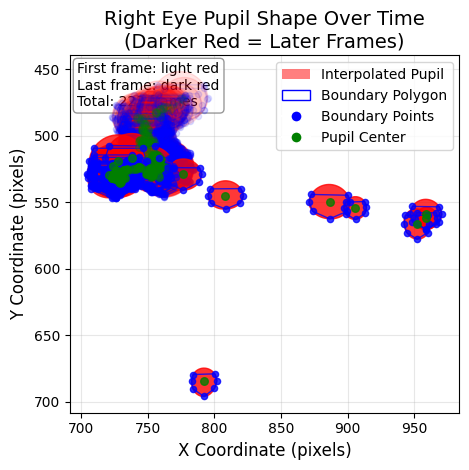

In [14]:
# Total number of valid frames for color gradient calculation
num_frames = len(valid_frames)
if num_frames == 0:
    print("No valid frames to plot")
else:
    print(f"Plotting {num_frames} frames")

    # Base color (red) with alpha for transparency
    base_color = to_rgba('red')
    
    # Create a collection to hold all interpolated polygons for legend
    interp_polygon_for_legend = None
    boundary_polygon_for_legend = None
    center_point_for_legend = None
    
    # Plot each frame's pupil shape
    for i, idx in enumerate(valid_frames):
        # Calculate color intensity based on frame position (later frames = darker)
        # Start with alpha=0.1 for first frame, gradually increase to 0.8 for last frame
        alpha = 0.1 + 0.7 * (i / (num_frames - 1)) if num_frames > 1 else 0.5
        # Create darker shades of red as we progress through frames
        darkness_factor = i / (num_frames - 1) if num_frames > 1 else 0.5
        frame_color = (base_color[0], 
                      base_color[1] * (1 - 0.7 * darkness_factor),  
                      base_color[2] * (1 - 0.7 * darkness_factor),
                      alpha)
        
        # Get interpolated points for this frame
        interp_points = interpolated_points_dict[idx]
        
        # Create and plot the interpolated polygon
        interp_poly = plt.Polygon(interp_points, 
                                  color=frame_color, 
                                  fill=True, 
                                  alpha=alpha,
                                  zorder=10+i)  # Ensure later frames overlay earlier ones
                                  
        plt.gca().add_patch(interp_poly)
        
        # Save one polygon for legend
        if interp_polygon_for_legend is None:
            interp_polygon_for_legend = interp_poly
        
        # Get the boundary points for this frame by extracting from the full frame data
        frame_df = landmarks_df_cleaned.iloc[[idx]]
        eye = 'right'  # We're focusing on right eye
        boundary_points = get_pupil_boundary_points(frame_df, eye)
        
        # Create a polygon from original boundary points
        # Close the polygon by adding first point at end
        boundary_poly_points = boundary_points + [boundary_points[0]]
        
        # Plot boundary polygon with blue color, no fill, only outline
        boundary_poly = plt.Polygon(boundary_poly_points, 
                                   fill=False, 
                                   edgecolor='blue', 
                                   linewidth=1,
                                   alpha=alpha,
                                   zorder=50+i)
        plt.gca().add_patch(boundary_poly)
        
        # Save one boundary polygon for legend
        if boundary_polygon_for_legend is None:
            boundary_polygon_for_legend = boundary_poly
        
        # Plot the original boundary points as red dots
        x_points = [p[0] for p in boundary_points]
        y_points = [p[1] for p in boundary_points]
        plt.scatter(x_points, y_points, color='blue', s=20, alpha=alpha, zorder=100+i)
        
        # Get and plot pupil center
        center_x, center_y = get_pupil_center(frame_df, eye)
        center_point = plt.scatter(center_x, center_y, color='green', s=30, alpha=alpha, zorder=200+i)
        
        # Save one center point for legend
        if center_point_for_legend is None:
            center_point_for_legend = center_point

    # Set axis limits with some padding
    all_x = [p[0] for frame_points in interpolated_points_dict.values() for p in frame_points if p]
    all_y = [p[1] for frame_points in interpolated_points_dict.values() for p in frame_points if p]
    
    if all_x and all_y:
        # Calculate padding as 5% of the range
        x_padding = (max(all_x) - min(all_x)) * 0.05
        y_padding = (max(all_y) - min(all_y)) * 0.05
        
        plt.xlim(min(all_x) - x_padding, max(all_x) + x_padding)
        plt.ylim(max(all_y) + y_padding, min(all_y) - y_padding)  # Invert y-axis to match image coordinates
    
    # Add legend using saved examples
    legend_elements = [
        patches.Patch(facecolor='red', alpha=0.5, label='Interpolated Pupil'),
        patches.Patch(facecolor='white', edgecolor='blue', label='Boundary Polygon'),
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='blue', markersize=8, label='Boundary Points'),
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='green', markersize=8, label='Pupil Center')
    ]
    plt.legend(handles=legend_elements, loc='upper right')
    
    # Add title and labels
    plt.title('Right Eye Pupil Shape Over Time\n(Darker Red = Later Frames)', fontsize=14)
    plt.xlabel('X Coordinate (pixels)', fontsize=12)
    plt.ylabel('Y Coordinate (pixels)', fontsize=12)
    
    # Add a note about the frame count and direction
    plt.annotate(f'First frame: light red\nLast frame: dark red\nTotal: {num_frames} frames', 
                xy=(0.02, 0.98), xycoords='axes fraction',
                bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="gray", alpha=0.8),
                fontsize=10, ha='left', va='top')
    
    # Use equal aspect ratio to prevent distortion
    plt.gca().set_aspect('equal')
    
    # Add grid for better readability
    plt.grid(alpha=0.3)
    
    plt.tight_layout()
    plt.show()

In [15]:
# Convert timestamp string to datetime objects
landmarks_df_calculated['timestamp_dt'] = pd.to_datetime(landmarks_df_calculated['timestamp'], errors='coerce')
landmarks_df_calculated

,Unnamed: 0,timestamp,id,retcode,left_lm_1_x,left_lm_1_y,left_lm_2_x,left_lm_2_y,left_lm_3_x,left_lm_3_y,left_lm_4_x,left_lm_4_y,left_lm_5_x,left_lm_5_y,left_lm_6_x,left_lm_6_y,left_lm_7_x,left_lm_7_y,left_lm_8_x,left_lm_8_y,left_lm_9_x,left_lm_9_y,left_lm_10_x,left_lm_10_y,left_lm_11_x,left_lm_11_y,left_lm_12_x,left_lm_12_y,left_lm_13_x,left_lm_13_y,left_lm_14_x,left_lm_14_y,left_lm_15_x,left_lm_15_y,left_lm_16_x,left_lm_16_y,left_lm_17_x,left_lm_17_y,left_lm_18_x,left_lm_18_y,left_lm_19_x,left_lm_19_y,left_lm_20_x,left_lm_20_y,left_lm_21_x,left_lm_21_y,left_lm_22_x,left_lm_22_y,left_lm_23_x,left_lm_23_y,...,right_lm_4_y,right_lm_5_x,right_lm_5_y,right_lm_6_x,right_lm_6_y,right_lm_7_x,right_lm_7_y,right_lm_8_x,right_lm_8_y,right_lm_9_x,right_lm_9_y,right_lm_10_x,right_lm_10_y,right_lm_11_x,right_lm_11_y,right_lm_12_x,right_lm_12_y,right_lm_13_x,right_lm_13_y,right_lm_14_x,right_lm_14_y,right_lm_15_x,right_lm_15_y,right_lm_16_x,right_lm_16_y,right_lm_17_x,right_lm_17_y,right_lm_18_x,right_lm_18_y,right_lm_19_x,right_lm_19_y,right_lm_20_x,right_lm_20_y,right_lm_21_x,right_lm_21_y,right_lm_22_x,right_lm_22_y,right_lm_23_x,right_lm_23_y,right_lm_24_x,right_lm_24_y,right_lm_25_x,right_lm_25_y,right_lm_26_x,right_lm_26_y,right_lm_27_x,right_lm_27_y,interpolated_area,non_interpolated_area,timestamp_dt
0,0,2024-08-08 03:36:14.477,1650,OK,178.0,507.5,234.0,465.2,272.0,458.8,310.0,461.2,362.0,499.8,321.8,484.2,294.0,484.5,275.5,484.5,275.5,501.2,256.8,484.5,226.0,485.0,236.8,534.8,275.8,529.0,312.5,524.0,344.8,513.0,401.0,503.8,343.2,474.0,314.2,507.8,274.8,533.2,236.0,509.5,203.0,528.5,259.0,493.2,259.0,476.0,...,446.5,684.8,490.2,729.0,471.2,753.8,471.5,774.5,471.5,774.5,489.8,795.0,471.5,823.5,471.5,812.0,521.5,774.2,520.2,737.0,514.8,704.8,505.2,651.8,496.5,703.2,462.5,737.5,496.8,774.0,523.0,814.8,497.2,845.2,510.5,792.0,481.0,792.0,461.8,756.5,461.8,757.0,481.2,844.5,458.2,886.5,487.8,1220.212184,890.015,2024-08-08 03:36:14.477
1,1,2024-08-08 03:36:14.514,1651,OK,182.2,508.2,236.8,466.0,275.5,459.5,312.8,463.2,363.2,503.2,324.2,485.8,296.2,485.8,279.2,485.8,279.2,502.0,262.0,485.8,228.8,486.0,238.8,537.0,279.5,532.8,314.2,527.8,346.5,517.0,404.2,506.8,345.2,477.2,316.0,510.8,277.5,535.8,238.5,512.5,205.5,530.0,264.5,494.2,264.2,478.0,...,448.0,689.0,492.0,731.0,472.8,759.5,473.0,776.8,473.0,776.8,488.0,794.5,472.8,826.0,472.5,815.5,521.2,776.8,520.5,739.5,515.2,707.2,506.0,653.8,497.0,706.0,463.5,738.8,498.5,777.0,522.8,817.8,497.5,848.2,511.2,792.0,481.0,792.0,464.5,762.0,464.8,762.0,481.2,847.8,461.5,887.0,490.8,873.266833,638.105,2024-08-08 03:36:14.514
2,2,2024-08-08 03:36:14.548,1652,OK,175.8,509.8,231.5,468.0,271.2,461.2,308.5,464.5,359.0,502.0,321.0,487.8,293.8,488.0,274.8,488.0,274.8,505.0,256.0,488.0,225.2,488.2,234.0,535.8,275.0,532.5,310.5,526.5,343.0,516.8,397.8,506.2,341.8,477.2,313.0,511.0,273.2,534.8,234.5,513.0,201.0,529.2,258.5,497.0,258.2,479.2,...,448.8,686.8,494.5,726.5,477.0,755.2,477.0,773.0,477.0,773.0,492.8,790.5,477.0,822.2,477.0,814.8,521.8,772.8,521.5,738.2,516.0,706.0,507.2,652.2,500.5,704.5,465.2,733.5,501.2,776.8,523.8,815.0,500.5,847.0,511.5,788.0,485.2,788.0,468.5,757.8,468.8,757.8,485.2,846.2,461.8,885.0,491.8,895.195093,656.765,2024-08-08 03:36:14.548
3,3,2024-08-08 03:36:14.580,1653,OK,173.5,510.0,229.2,467.5,268.2,461.0,307.0,464.0,359.5,503.0,318.0,488.0,290.2,488.2,272.8,488.2,272.8,504.2,254.8,488.2,222.8,488.5,231.8,537.2,272.8,533.0,309.0,527.5,341.8,516.8,394.5,506.2,340.5,477.0,310.8,511.0,270.5,535.5,231.5,513.5,198.0,531.0,257.5,496.8,257.2,480.2,...,449.2,682.0,494.0,724.2,476.0,755.8,476.0,769.2,476.0,769.2,488.2,783.0,476.0,818.0,476.0,811.2,523.0,769.2,522.5,734.5,517.2,702.5,507.8,650.2,499.2,701.2,466.0,731.8,501.2,772.8,525.0,810.5,501.0,843.5,511.8,781.0,482.5,781.2,469.8,757.8,469.8,757.8,482.5,843.0,463.5,880.8,491.0,530.345357,386.780,2024-08-08 03:36:14.580
4,4,2024-08-08 03:36:14.609,1654,OK,171.5,511.0,226.8,469.5,265.8,463.8,303.2,467.0,355.2,504.8,315.0,491.2,287.2,491.

In [16]:
# ... existing imports ...
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import numpy as np # Ensure numpy is imported

def create_pupil_animation(save_path=None):
    """Create and optionally save an animation of pupil changes over time"""
    # Filter out frames with NaN area
    # valid_frames = sorted([idx for idx in interpolated_points_dict.keys() 
    #                       if not np.isnan(landmarks_df_calculated.loc[idx, 'interpolated_area']) and
    #                          not np.isnan(landmarks_df_calculated.loc[idx, 'time_elapsed_s'])]) # Add check for time
    
    # if not valid_frames:
    #     print("No valid frames to animate")
    #     return None
    
    # Get limits for consistent scaling
    all_x = [p[0] for frame_points in interpolated_points_dict.values() for p in frame_points if p]
    all_y = [p[1] for frame_points in interpolated_points_dict.values() for p in frame_points if p]
    
    x_padding = (max(all_x) - min(all_x)) * 0.1
    y_padding = (max(all_y) - min(all_y)) * 0.1
    
    x_min, x_max = min(all_x) - x_padding, max(all_x) + x_padding
    y_min, y_max = min(all_y) - y_padding, max(all_y) + y_padding
    
    # Create the figure and axes
    fig, ax = plt.subplots(figsize=(8, 8))
    
    # Initialize empty objects for animation
    interp_poly = plt.Polygon([[0,0]], color='red', alpha=0.3, label='Interpolated Pupil')
    boundary_poly, = plt.plot([], [], 'b-', linewidth=2, label='Boundary Polygon')
    boundary_points = plt.scatter([], [], color='blue', s=50, label='Boundary Points')
    center_point = plt.scatter([], [], color='green', s=100, label='Pupil Center')
    info_text = plt.text(0.02, 0.02, '', transform=ax.transAxes, 
                          bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="gray", alpha=0.8))
    
    # Add these to the axes
    ax.add_patch(interp_poly)
    
    # Set fixed axis limits
    ax.set_xlim(x_min, x_max)
    ax.set_ylim(y_max, y_min)  # Invert y-axis to match image coordinates
    
    # Add labels and grid
    ax.set_xlabel('X Coordinate (pixels)', fontsize=12)
    ax.set_ylabel('Y Coordinate (pixels)', fontsize=12)
    ax.grid(alpha=0.3)
    ax.set_aspect('equal')
    ax.legend(loc='upper right')
    
    # Animation initialization function (remains the same)
    def init():
        interp_poly.set_xy([[0,0]])
        boundary_poly.set_data([], [])
        boundary_points.set_offsets([[0,0]])
        center_point.set_offsets([[0,0]])
        info_text.set_text('')
        return interp_poly, boundary_poly, boundary_points, center_point, info_text

    # Animation update function
    def update(frame_idx):
        idx = valid_frames[frame_idx]
        frame_df = landmarks_df_cleaned.iloc[[idx]] # Still use cleaned for geometry
        eye = 'right'
        
        # Get center and boundary points for this frame
        center_x, center_y = get_pupil_center(frame_df, eye)
        boundary_pts = get_pupil_boundary_points(frame_df, eye)
        boundary_poly_pts = boundary_pts + [boundary_pts[0]]
        
        # Get interpolated points
        interp_pts = interpolated_points_dict[idx]
        
        # --- Get values from landmarks_df_calculated using the index 'idx' ---
        interp_area = landmarks_df_calculated.loc[idx, 'interpolated_area']
        non_interp_area = landmarks_df_calculated.loc[idx, 'non_interpolated_area']
        # time_elapsed = landmarks_df_calculated.loc[idx, 'time_elapsed_s'] # Use the new numeric time column
        
        # Update the plots
        interp_poly.set_xy(interp_pts)
        boundary_poly.set_data([p[0] for p in boundary_poly_pts], [p[1] for p in boundary_poly_pts])
        boundary_points.set_offsets(boundary_pts)
        center_point.set_offsets([[center_x, center_y]])
        
        # # --- Format using the numeric time_elapsed ---
        # # (Remove the try-except blocks for timestamp if you want, or keep them for area)
        # try:
        #     ts_str = f"{time_elapsed:.3f}" # Format the numeric time_elapsed
        # except (ValueError, TypeError) as e:
        #     print(f"Error formatting time_elapsed at index {idx}: Value={time_elapsed}, Type={type(time_elapsed)}, Error={e}")
        #     ts_str = "Error"

        # try:
        #     ia_str = f"{interp_area:.2f}"
        # except (ValueError, TypeError) as e:
        #     print(f"Error formatting interp_area at index {idx}: Value={interp_area}, Type={type(interp_area)}, Error={e}")
        #     ia_str = "Error"

        # try:
        #     nia_str = f"{non_interp_area:.2f}"
        # except (ValueError, TypeError) as e:
        #     print(f"Error formatting non_interp_area at index {idx}: Value={non_interp_area}, Type={type(non_interp_area)}, Error={e}")
        #     nia_str = "Error"

        # # Update the text information using the potentially modified strings
        # info_text.set_text(f'Frame: {idx}\nTime: {ts_str}s\n' # Changed label to Time
        #                   f'Interp Area: {ia_str} px²\n'
        #                   f'Non-interp Area: {nia_str} px²')
        
        # Update title
        ax.set_title(f'Right Eye Pupil - Frame {idx}/{max(valid_frames)}', fontsize=14)
        
        return interp_poly, boundary_poly, boundary_points, center_point, info_text
    
    # Create animation
    frames = len(valid_frames)
    ani = FuncAnimation(fig, update, frames=frames, init_func=init, 
                        blit=True, interval=200, repeat=True)
    
    # Save if requested
    if save_path:
        # Consider adding a try-except around save if it also causes issues
        try:
            ani.save(save_path, writer='pillow', fps=5)
            print(f"Animation saved to {save_path}")
        except Exception as e:
            print(f"Error saving animation: {e}")

    plt.tight_layout()
    plt.close()  # Close to prevent showing twice
    return ani

animation = create_pupil_animation()
if animation:
    try:
        display(HTML(animation.to_jshtml())) # Use display() for better rendering in notebooks
    except Exception as e:
        print(f"Error generating JSHTML for animation: {e}")
        # Fallback or further debugging needed here
else:
    print("Failed to create animation")


2025-04-16 01:56:23,856 - INFO - Animation.save using <class 'matplotlib.animation.HTMLWriter'>


In [22]:
# --- Animation with Trail, More Modular Structure ---
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from collections import deque
from matplotlib.colors import to_rgba, LinearSegmentedColormap
from pathlib import Path

def create_pupil_animation(save_path=None, trail_length=5):
    """Create and optionally save an animation of pupil changes over time with center trail.
    
    Args:
        save_path: Optional path to save the animation
        trail_length: Number of past frames to show in the trail
    
    Returns:
        Animation object that can be displayed
    """
    # --- Step 1: Data Preparation ---
    timestamps, valid_frames, time_elapsed = prepare_data()
    if not valid_frames:
        return None
    
    # --- Step 2: Set up plot limits ---
    x_min, x_max, y_min, y_max = calculate_plot_limits(valid_frames)
    
    # --- Step 3: Create figure and initialize plot elements ---
    fig, ax, plot_elements = initialize_plot(x_min, x_max, y_min, y_max, trail_length)
    
    # --- Step 4: Set up animation ---
    frames_count = len(valid_frames)
    ani = create_animation(fig, plot_elements, valid_frames, frames_count)
    
    # --- Step 5: Save if requested ---
    if save_path:
        save_animation(ani, save_path)
    
    plt.close(fig)  # Close the figure to prevent static display in notebook
    return ani

def prepare_data(max_frames=150):
    """Prepare timestamp data and find valid frames for animation."""
    # Ensure timestamp_dt exists and is datetime type
    if 'timestamp_dt' not in landmarks_df_calculated.columns or not pd.api.types.is_datetime64_any_dtype(landmarks_df_calculated['timestamp_dt']):
        landmarks_df_calculated['timestamp_dt'] = pd.to_datetime(landmarks_df_calculated['timestamp'], errors='coerce')
    
    first_timestamp = landmarks_df_calculated['timestamp_dt'].dropna().min()
    if pd.isna(first_timestamp):
        print("Error: Could not determine the first valid timestamp.")
        landmarks_df_calculated['time_elapsed_s'] = np.nan
    else:
        landmarks_df_calculated['time_elapsed_s'] = (landmarks_df_calculated['timestamp_dt'] - first_timestamp).dt.total_seconds()
    
    # Filter valid frames
    valid_frames_all = sorted([
        idx for idx in interpolated_points_dict.keys()
        if not np.isnan(landmarks_df_calculated.loc[idx, 'interpolated_area']) and
           not np.isnan(landmarks_df_calculated.loc[idx, 'time_elapsed_s'])
    ])
    
        # Limit the number of frames
    valid_frames = valid_frames_all[:max_frames] # Take only the first max_frames
    
    if not valid_frames:
        print("No valid frames to animate")
        return None, None, None
    
    print(f"Using {len(valid_frames)} frames for animation (limited from {len(valid_frames_all)}).") # Add print statement
    
    return landmarks_df_calculated['timestamp_dt'], valid_frames, landmarks_df_calculated['time_elapsed_s']

def calculate_plot_limits(valid_frames):
    """Calculate plot limits based on all valid points."""
    # Get all valid points
    all_x = [p[0] for idx in valid_frames for p in interpolated_points_dict[idx] if p]
    all_y = [p[1] for idx in valid_frames for p in interpolated_points_dict[idx] if p]
    
    if not all_x or not all_y:
        print("No valid points found for setting animation limits.")
        return None, None, None, None
    
    # Add padding
    x_padding = (max(all_x) - min(all_x)) * 0.1 if max(all_x) != min(all_x) else 10
    y_padding = (max(all_y) - min(all_y)) * 0.1 if max(all_y) != min(all_y) else 10
    
    x_min = min(all_x) - x_padding
    x_max = max(all_x) + x_padding
    y_min = min(all_y) - y_padding
    y_max = max(all_y) + y_padding
    
    return x_min, x_max, y_min, y_max

def initialize_plot(x_min, x_max, y_min, y_max, trail_length):
    """Initialize the figure, axes and plot elements."""
    # Create figure and axes
    fig, ax = plt.subplots(figsize=(8, 8))
    
    # Base color for center trail (deep purple)
    base_color = (0.5, 0, 0.5)  # RGB values for purple
    
    # Initialize plot elements
    interp_poly = plt.Polygon([[0, 0]], color='red', alpha=0.3, label='Current Pupil', zorder=10)
    boundary_poly, = plt.plot([], [], 'b-', linewidth=1, alpha=0.5, label='Current Boundary', zorder=20)
    
    # Center trail scatter - will set colors individually during update; using facecolors=[]
    center_trail_scatter = plt.scatter(
        [], [], 
        s=50,             # Size of markers
        facecolors='none',     # Will be set during update
        label='Center Trail',
        zorder=30,
        edgecolors='purple',   # Add purple edge color
        linewidths=1         # Control the outline width
    )
    
    info_text = plt.text(
        0.02, 0.02, '',
        transform=ax.transAxes,
        bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="gray", alpha=0.8),
        zorder=50
    )
    
    # Add patch to axes
    ax.add_patch(interp_poly)
    
    # Set plot limits and labels
    ax.set_xlim(x_min, x_max)
    ax.set_ylim(y_max, y_min)  # Invert y-axis for image coordinates
    ax.set_xlabel('X Coordinate (pixels)', fontsize=12)
    ax.set_ylabel('Y Coordinate (pixels)', fontsize=12)
    ax.grid(alpha=0.3)
    ax.set_aspect('equal')
    ax.legend(loc='upper right')
    
    plot_elements = {
        'interp_poly': interp_poly,
        'boundary_poly': boundary_poly,
        'center_trail_scatter': center_trail_scatter,
        'info_text': info_text,
        'ax': ax,
        'center_history': deque(maxlen=trail_length),
        'base_color': base_color
    }
    
    return fig, ax, plot_elements

def create_animation(fig, plot_elements, valid_frames, frames_count):
    """Create the animation using FuncAnimation."""
    # Extract elements from the plot_elements dictionary
    interp_poly = plot_elements['interp_poly']
    boundary_poly = plot_elements['boundary_poly']
    center_trail_scatter = plot_elements['center_trail_scatter']
    info_text = plot_elements['info_text']
    ax = plot_elements['ax']
    center_history = plot_elements['center_history']
    base_color = plot_elements['base_color']
    
    def init():
        interp_poly.set_xy([[0, 0]])
        boundary_poly.set_data([], [])
        center_trail_scatter.set_offsets(np.empty((0, 2)))
        center_trail_scatter.set_edgecolors(np.empty((0, 4)))  # Change from set_facecolors
        center_trail_scatter.set_facecolors('none')  # Explicitly set to 'none'
        info_text.set_text('')
        center_history.clear()
        return interp_poly, boundary_poly, center_trail_scatter, info_text
    
    # Define frame update function
    def update(frame_idx):
        # Get the current frame index
        idx = valid_frames[frame_idx]
        frame_df = landmarks_df_cleaned.iloc[[idx]]
        eye = 'right'
        
        # Get current points for this frame
        center_x, center_y = get_pupil_center(frame_df, eye)
        boundary_pts = get_pupil_boundary_points(frame_df, eye)
        boundary_poly_pts = boundary_pts + [boundary_pts[0]]
        interp_pts = interpolated_points_dict[idx]
        
        # Update the center point history
        center_history.append((center_x, center_y))
        
        # Update the current frame polygon and boundary
        interp_poly.set_xy(interp_pts)
        boundary_poly.set_data([p[0] for p in boundary_poly_pts], [p[1] for p in boundary_poly_pts])
        
        # Update the center trail with gradient transparency
        update_center_trail(center_history, center_trail_scatter, base_color)
        
        # Update text information
        update_info_text(idx, info_text)
        
        # Update title
        ax.set_title(f'Right Eye Pupil - Frame {frame_idx+1}/{len(valid_frames)} (Index: {idx})', fontsize=14)
        
        return interp_poly, boundary_poly, center_trail_scatter, info_text
    
    # Create the animation
    ani = FuncAnimation(
        fig, update, frames=frames_count, init_func=init,
        blit=False, interval=100, repeat=True
    )
    
    return ani

def update_center_trail(center_history, center_trail_scatter, base_color):
    """Update the center trail scatter plot with gradient transparency for outlines only."""
    num_points = len(center_history)
    
    if num_points > 0:
        # Convert trail points to array
        center_trail_offsets = np.array(list(center_history))
        
        # Create gradient colors with increasing alpha values
        # Min alpha (oldest point): 0.1; Max alpha (newest point): 1.0
        min_alpha = 0.1
        max_alpha = 1.0
        
        # Create the color array with RGBA values for edges only
        edge_colors = []
        for i in range(num_points):
            # i=0 is the oldest, i=num_points-1 is the newest
            alpha = min_alpha + (max_alpha - min_alpha) * (i / (num_points - 1)) if num_points > 1 else max_alpha
            edge_colors.append((*base_color, alpha))  # RGBA tuple
        
        # Update scatter with positions and edge colors 
        center_trail_scatter.set_offsets(center_trail_offsets)
        center_trail_scatter.set_edgecolors(edge_colors)  # Set edge colors with transparency
        center_trail_scatter.set_facecolors('none')  # Explicitly set face colors to none
    else:
        # Handle empty history
        center_trail_scatter.set_offsets(np.empty((0, 2)))
        center_trail_scatter.set_edgecolors(np.empty((0, 4)))
        center_trail_scatter.set_facecolors('none')

def update_info_text(idx, info_text):
    """Update the information text with current metrics."""
    interp_area = landmarks_df_calculated.loc[idx, 'interpolated_area']
    non_interp_area = landmarks_df_calculated.loc[idx, 'non_interpolated_area']
    time_elapsed = landmarks_df_calculated.loc[idx, 'time_elapsed_s']
    
    # Format strings safely
    try:
        ts_str = f"{time_elapsed:.3f}"
    except:
        ts_str = "NaN"
    try:
        ia_str = f"{interp_area:.2f}"
    except:
        ia_str = "NaN"
    try:
        nia_str = f"{non_interp_area:.2f}"
    except:
        nia_str = "NaN"
    
    # Update text
    info_text.set_text(f'Frame Index: {idx}\nTime: {ts_str}s\n'
                       f'Interp Area: {ia_str} px²\n'
                       f'Non-interp Area: {nia_str} px²')

def save_animation(ani, save_path):
    """Save the animation to the specified path."""
    try:
        save_path = Path(save_path)
        save_path.parent.mkdir(parents=True, exist_ok=True)
        ani.save(str(save_path), writer='pillow', fps=10)
        print(f"Animation saved to {save_path}")
    except Exception as e:
        print(f"Error saving animation: {e}")

# --- Run the animation ---
output_dir = Path().cwd().parent / "output"
animation_save_path = output_dir / "pupil_animation_with_trail.gif"
output_dir.mkdir(parents=True, exist_ok=True)

# Create and display the animation
animation = create_pupil_animation(save_path=animation_save_path, trail_length=15)

if animation:
    try:
        display(HTML(animation.to_jshtml()))
    except Exception as e:
        print(f"Error generating JSHTML for animation: {e}")
else:
    print("Failed to create animation (check previous messages for errors).")


2025-04-16 02:20:27,567 - INFO - Animation.save using <class 'matplotlib.animation.PillowWriter'>


Using 150 frames for animation (limited from 223).


2025-04-16 02:20:47,824 - INFO - Animation.save using <class 'matplotlib.animation.HTMLWriter'>


Animation saved to /home/lrn/Repos/analyze-eye-tracking-data/output/pupil_animation_with_trail.gif
